# Week 5 Capstone

Notebook for the fifth week of *Applied Data Science Capstone*.


## Table of contents
* [Introduction](#Introduction)
* [Data](#Data)
 * [Data Acquisition](#DataAcquisition)
 * [Data Cleaning](#DataCleaning)
 * [Data Preparation and Feature Selection](#DataPreparation)
* [Preliminary Analysis](#PreliminaryAnalysis)
* [Predictive Modeling](#PredictiveModeling)
  * [Preprocessing](#Preprocessing)
  * [A Regression Approach](#RegressionApproach)
  * [A Classification  Approach](#ClassificationApproach)
* [Conclusions](#Conclusions)


# Introduction <a name="Introduction"></a>

In this notebook we will do an approach to a classification problem in the neighborhoods of Toronto. We will try to find a **correlation** between the **crime rates** of a neighborhood and the **venues** in said neighborhood. And while doing so solve some of these questions:

* Is there a correspondence between a predominant type of business and an exceptional high or low criminality?
* Are more diverse neighborhoods less crime prone?
* What characterizes neighborhoods of notable delinquency?

To do so, we will be using a data set from **Toronto 
Open Data** for crime rates, and **Foursquare Places API** for 
business and landmarks in each region.

# Data <a name="Data"></a>

As mentioned before, the data will be drawn from **Toronto 
Open Data** foundation  and **Foursquare Places API**.

## Data Adquisition <a name="DataAcquisition"></a>


In this secction we will obtain data from both sources previusly cited, Toronto Open Data foundation and Foursquare Places API.
The former is a geojson dataset, and the later a set of calls to a REST API, which will requiere some work to make usable.

> ### **Toronto Open Data - Toronto Neighborhoods’ Crime Rates**

We can get a perfectly clean dataset from Toronto Open Data.

Frist, we need to download and install the GeoPandas library given the nature geospactial of our data.

In [ ]:
# GeoPandas download and install
!pip install geopandas &>/dev/null


After that, we can download the data set from Toronto Open Data initiative.

In [ ]:
import pandas as pd # Primary data structure library
import geopandas as gpd # A yx data structure library

# URL of the dataset
url = "https://ckan0.cf.opendata.inter.prod-toronto.ca/download_resource/4754baf5-3715-4166-a347-eda9813521de?format=geojson&projection=4326"

# Read the Crime by Neighbourhood dataset
dfCrimes = gpd.read_file(url)
dfCrimes.head()


,_id,OBJECTID,Neighbourhood,Hood_ID,F2020_Population_Projection,Assault_2014,Assault_2015,Assault_2016,Assault_2017,Assault_2018,Assault_2019,Assault_2020,Assault_Rate2014,Assault_Rate2015,Assault_Rate2016,Assault_Rate2017,Assault_Rate2018,Assault_Rate2019,Assault_Rate2020,AutoTheft_2014,AutoTheft_2015,AutoTheft_2016,AutoTheft_2017,AutoTheft_2018,AutoTheft_2019,AutoTheft_2020,AutoTheft_Rate2014,AutoTheft_Rate2015,AutoTheft_Rate2016,AutoTheft_Rate2017,AutoTheft_Rate2018,AutoTheft_Rate2019,AutoTheft_Rate2020,BreakAndEnter_2014,BreakAndEnter_2015,BreakAndEnter_2016,BreakAndEnter_2017,BreakAndEnter_2018,BreakAndEnter_2019,BreakAndEnter_2020,...,TheftOver_2017,TheftOver_2018,TheftOver_2019,TheftOver_2020,TheftOver_Rate2014,TheftOver_Rate2015,TheftOver_Rate2016,TheftOver_Rate2017,TheftOver_Rate2018,TheftOver_Rate2019,TheftOver_Rate2020,Homicide_2014,Homicide_2015,Homicide_2016,Homicide_2017,Homicide_2018,Homicide_2019,Homicide_2020,Homicide_Rate2014,Homicide_Rate2015,Homicide_Rate2016,Homicide_Rate2017,Homicide_Rate2018,Homicide_Rate2019,Homicide_Rate2020,Shootings_2014,Shootings_2015,Shootings_2016,Shootings_2017,Shootings_2018,Shootings_2019,Shootings_2020,Shooting_Rate2014,Shootings_Rate2015,Shootings_Rate2016,Shootings_Rate2017,Shootings_Rate2018,Shootings_Rate2019,Shootings_Rate2020,geometry
0,1,1,Yonge-St.Clair,97,14083,16,25,34,25,28,35,23,127.0144,196.1246,262.5482,189.1790,207.2846,253.8071,163.3175,2,3,7,2,6,6,9,15.8768,23.53495,54.05405,15.13432,44.41812,43.50979,63.90684,37,20,12,18,24,28,26,...,0,3,6,3,23.81519,39.22491,54.05405,0.00000,22.20906,43.50979,21.30228,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,1,0,0,0,0,0.000000,0.000000,7.722008,0.000000,0.000000,0.000000,0.000000,"POLYGON ((-79.39115 43.68108, -79.39137 43.680..."
1,2,2,York University Heights,27,30277,273,298,363,351,362,382,341,950.5571,1041.4850,1269.3200,1211.0970,1230.3300,1279.8610,1126.2670,106,100,106,89,91,147,184,369.0808,349.49150,370.65530,307.08720,309.28190,492.51180,607.72200,108,140,98,105,122,111,105,...,40,38,31,43,104.45680,160.76610,132.87640,138.01670,129.15070,103.86300,142.02200,1,0,2,0,1,0,1,3.481894,0.000000,6.993496,0.000000,0.000000,0.000000,3.302837,2,0,4,10,8,6,12,6.963789,0.000000,13.986990,34.504170,27.189610,20.102520,39.634040,"POLYGON ((-79.50525 43.75987, -79.50484 43.759..."
2,3,3,Lansing-Westgate,38,18146,42,81,67,84,68,70,97,261.0966,494.6263,400.6698,492.5531,390.1543,393.5901,534.5530,17,22,26,26,16,30,44,105.6820,134.34290,155.48380,152.45690,91.80102,168.68150,242.47770,34,27,41,42,50,39,39,...,11,6,10,9,24.86634,30.53249,29.90073,64.50100,34.42538,56.22716,49.59771,0,0,0,0,10,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,1,0,1,2,1,0.000000,0.000000,5.980146,0.000000,5.737564,11.245430,5.510856,"POLYGON ((-79.43994 43.76156, -79.44000 43.761..."
3,4,4,Yorkdale-Glen Park,31,17560,106,137,175,163,178,210,156,697.5061,902.0279,1149.1990,1031.8410,1086.5580,1237.4050,888.3827,63,53,41,54,64,64,87,414.5555,348.95970,269.24090,341.83710,390.67270,377.11390,495.44420,51,57,66,62,67,90,81,...,23,20,30,18,151.34570,98.76218,170.73810,145.59730,122.08520,176.77210,102.50570,1,1,1,1,2,1,1,6.580246,6.584146,6.566851,6.330316,6.104261,5.892405,5.694761,3,3,3,7,10,17,14,19.740740,19.752440,19.700550,44.312210,61.042610,100.170900,79.726650,"POLYGON ((-79.43965 43.70561, -79.44007 43.705..."
4,5,5,Stonegate-Queensway,16,27410,91,74,78,98,86,83,104,354.9696,288.1732,302.5249,374.5318,323.2961,307.3277,379.4236,37,32,14,33,31,35,45,144.3283,124.61540,54.29934,126.11790,116.53700,129.59600,164.17370,70,45,49,50,39,64,35,...,6,8,4,5,31.20612,31.15386,15.51410,22.93052,30.07406,14.81098,18.24152,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3,2,0,1,1,1,0,11.702290,7.788465,0.000000,3.821754,3.759257,3.702744,0.000000,"POLYGON ((-79.49258 43.64744, -79.49273 43.647..."


**Bonus**: We are gona define a variables Longitude and latitude to the dataset to ease or job in lather stages.
Each neighborhood has a poligon that represents it in a world map. We can use its centroid to define these variables


In [ ]:
# Assign longitude y latitude to each neighbourhood using its centroid
Centroids = dfCrimes[["geometry"]].centroid
dfCrimes["Longitude"] = Centroids.x
dfCrimes["Latitude"] = Centroids.y
dfCrimes[["Neighbourhood", "Longitude", "Latitude"]].head()


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  


,Neighbourhood,Longitude,Latitude
0,Yonge-St.Clair,-79.397831,43.687859
1,York University Heights,-79.488842,43.765738
2,Lansing-Westgate,-79.424706,43.754272
3,Yorkdale-Glen Park,-79.457068,43.714673
4,Stonegate-Queensway,-79.501091,43.635520


> ### **FOURSQUARE Places API - Toronto's Business and Landmarks**

This one is a more cumbersome source of data.

First we need to define our credential to make HTTP request to the API. After that, we make a call for each neighborhood and retrive the nearby venues and bussines.

In [ ]:
# Foursqaure Api parameters
CLIENT_ID = 'E1USLAAIPTVMHO5OH2XUQKBNTDGC3RVOBTNFG00B2FBBEJY3' # your Foursquare ID
CLIENT_SECRET = 'CLZTA1BZGSF0HTIXJR3WYHHDCV3GVMUDEP3WLNQ3U2YTIXUC' # your Foursquare Secret
ACCESS_TOKEN = 'X0YKZOHKVQ0TGHJVIQC0W312OKVGSMO2JV3ASLAZONADHGNA' # your FourSquare Access Token
VERSION = '20180605' # Foursquare API version


Credentials done. Now lets define a function to make a call for each neighborhood in the Crime Rates dataframe. We can use the responses to make a separate daframe with a list of venues/bussiness relating to one comunity.

In [ ]:
# Method for searching venues for each Neighborhood in a dataframe
def getVenuesFromDataset(dataframe, name="Neighbourhood"):
    # Init some variables
    neighbourhoods = dataframe[name]
    latitudes = dataframe["Latitude"]
    longitudes = dataframe["Longitude"]
    # Aux vector for dataframe
    venues = []
    # For each neighbourhood
    for name, lat, lng in zip(neighbourhoods, latitudes, longitudes):
        # Create the API request URL
        url = exploreURL.format(CLIENT_ID, CLIENT_SECRET, VERSION, lat, lng , RADIUS, LIMIT)
        # Make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        # Return only relevant information for each nearby venue
        venues.append([(
            name,
            v['venue']['name'],
            v['venue']['categories'][0]['name'],
            v['venue']['location']['lat'], 
            v['venue']['location']['lng']) for v in results])
    
    # Transfor aux vector in dataframe
    nearbyVenues = pd.DataFrame([venue for venues in venues for venue in venues])
    nearbyVenues.columns = ['Neighbourhood', 
                  'Venue',
                  'Venue Category',
                  'Venue Latitude', 
                  'Venue Longitude']

    #Return the new dataframe
    return(nearbyVenues)


Almost ready, we need a template and paramethers for the URL requests that we will use for the API calls.

In [ ]:
# Explore URL Template
exploreURL = "https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}"
LIMIT = 300 # Limit of number of venues returned by Foursquare API
RADIUS = 1200 # Define radius
exploreURL


'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'

Finally, lets get the data from FOURSQUARE.

In [ ]:
import requests # Library to handle HTTP requests

# Search venues for each Neighbourhood
dfAux = getVenuesFromDataset(dfCrimes)
dfAux.head()


,Neighbourhood,Venue,Venue Category,Venue Latitude,Venue Longitude
0,Yonge-St.Clair,Daeco Sushi,Sushi Restaurant,43.687838,-79.395652
1,Yonge-St.Clair,The Bagel House,Bagel Shop,43.687374,-79.393696
2,Yonge-St.Clair,Capocaccia Café,Italian Restaurant,43.685915,-79.393305
3,Yonge-St.Clair,9bars,Café,43.688660,-79.391940
4,Yonge-St.Clair,Waxon Waxbar,Spa,43.682824,-79.391971


## Data Cleaning <a name="DataCleaning"></a>


Lets work a bit with the FOURSQUARE data so it fits bether to the problema at hand.

First, we need to reduce the dimensionality of the "Venue Category"	propiety.

In [ ]:
# Print unique values in a propety
print("Number of diferent Venue Categories : "+ str(dfAux[["Venue Category"]].nunique()[0]))


Number of diferent Venue Categories : 9


335 diferent values are too many for us to work with.

Lets define a function that given a category, return us a category of higger level. We can do this thanks to the hierachical structure of FOURSQUARE PLACES API's categories.

In [ ]:
# This method gives us a higher category given a one. 
# Stop will tell the degree of the category we want returned. The higger the degree, 
# the higger the granularity of the category
def getHigherCat(stop, name, categories, level=0):
    # We find a match, we return the category
    if(str(categories["name"]) == name):
        return categories["name"]
    # For each sub-category
    subCat = categories["categories"]
    for i, category in enumerate(subCat):
        # Make a recursive call
        result = getHigherCat(stop, name, category,level+1)
        # If resturns something
        if result is not None:
            # If we are below the threshold, we change the category returned
            if level >= stop:
                return categories["name"]
            return result

# Auxiliar method
def getHigherCategorie(stop, name, categories):
    for category in categories:
        result = getHigherCat(stop, name, category)
        if(result is not None):
            return result

First, we need to get the categories structure. There is a URL to the get these in the API.

In [ ]:
# Categories URL Template
categoriesURL = "https://api.foursquare.com/v2/venues/categories?&client_id={}&client_secret={}&v={}"

# Create the API request URL
urlCategories = categoriesURL.format(CLIENT_ID, CLIENT_SECRET, VERSION)

# We get the categories from the API
results = requests.get(urlCategories).json()
categories = results["response"]["categories"]


Now we are ready to apply the method to the data set.

We make a call for each category and display the results.

In [ ]:
# Apply dimension reduction
dfAux["Venue Category"] = dfAux.apply(lambda row: getHigherCategorie(0, row["Venue Category"], categories), axis=1)
dfAux.head()


,Neighbourhood,Venue,Venue Category,Venue Latitude,Venue Longitude
0,Yonge-St.Clair,Daeco Sushi,Food,43.687838,-79.395652
1,Yonge-St.Clair,The Bagel House,Food,43.687374,-79.393696
2,Yonge-St.Clair,Capocaccia Café,Food,43.685915,-79.393305
3,Yonge-St.Clair,9bars,Food,43.688660,-79.391940
4,Yonge-St.Clair,Waxon Waxbar,Shop & Service,43.682824,-79.391971


After reducing the dimensionality we can group the venues on their Neighbourhood by their category.


In [ ]:
# Lets add together all occurrences of the same type by Neighbourhood
dfCategories = pd.get_dummies(dfAux[['Venue Category']], prefix = "", prefix_sep = "")
dfCategories['Neighbourhood'] = dfAux['Neighbourhood']
dfCategories = dfCategories.groupby('Neighbourhood').sum().reset_index()
# ? dfCategories = dfCategories.set_index("Neighbourhood")

# We sort the dataframe for bether visualization
dfCategories = dfCategories.sort_values(by = dfCategories.index.tolist(), axis = 1, ascending=False)
dfCategories.head()


,Neighbourhood,Food,Shop & Service,Outdoors & Recreation,Travel & Transport,Arts & Entertainment,Nightlife Spot,Professional & Other Places,College & University,Residence
0,Agincourt North,24,18,1,1,1,0,0,0,0
1,Agincourt South-Malvern West,38,12,5,1,1,1,0,0,0
2,Alderwood,8,15,6,3,0,2,0,0,0
3,Annex,59,20,7,2,6,5,1,0,0
4,Banbury-Don Mills,24,12,3,1,2,0,0,0,0


## Data Preparation and Feature Selection <a name="DataPreparation"></a>

Lets look again into the Toronto Open Data data set.

In [ ]:
# Display the dataframe
dfCrimes.head(2)


,Neighbourhood,F2020_Population_Projection,Assault_Rate2020,AutoTheft_Rate2020,BreakAndEnter_2020,Robbery_Rate2020,TheftOver_Rate2020,Homicide_Rate2020,Shootings_Rate2020,geometry,SumCrimes,SumCrimesBinned,SumCrimesCate
0,Yonge-St.Clair,14083,163.3175,63.90684,26,35.5038,21.30228,0.000000,0.00000,"POLYGON ((-79.39115 43.68108, -79.39137 43.680...",310.030420,Low,0
1,York University Heights,30277,1126.2670,607.72200,105,155.2334,142.02200,3.302837,39.63404,"POLYGON ((-79.50525 43.75987, -79.50484 43.759...",2179.181277,High,2


There are too many columns, which makes the dataframe hard to read. 
In addition we are gona work only with 2020 related data. 
Lets drop what we wont need.

We are interested in the 2020 crime ponderated data, the neigbourhood name, population proyection on geometry.

In [ ]:
# Get the fields that interest us
relevantFields = ["Neighbourhood", "F2020_Population_Projection", "Assault_Rate2020", "AutoTheft_Rate2020", "Robbery_Rate2020", "BreakAndEnter_2020",
                  "TheftOver_Rate2020", "Homicide_Rate2020", "Shootings_Rate2020", "geometry"]
# Drop everything else
dfCrimes.drop(dfCrimes.columns.difference(relevantFields), 1, inplace=True)
dfCrimes.head()


,Neighbourhood,F2020_Population_Projection,Assault_Rate2020,AutoTheft_Rate2020,BreakAndEnter_2020,Robbery_Rate2020,TheftOver_Rate2020,Homicide_Rate2020,Shootings_Rate2020,geometry
0,Yonge-St.Clair,14083,163.3175,63.90684,26,35.50380,21.30228,0.000000,0.000000,"POLYGON ((-79.39115 43.68108, -79.39137 43.680..."
1,York University Heights,30277,1126.2670,607.72200,105,155.23340,142.02200,3.302837,39.634040,"POLYGON ((-79.50525 43.75987, -79.50484 43.759..."
2,Lansing-Westgate,18146,534.5530,242.47770,39,60.61942,49.59771,0.000000,5.510856,"POLYGON ((-79.43994 43.76156, -79.44000 43.761..."
3,Yorkdale-Glen Park,17560,888.3827,495.44420,81,227.79040,102.50570,5.694761,79.726650,"POLYGON ((-79.43965 43.70561, -79.44007 43.705..."
4,Stonegate-Queensway,27410,379.4236,164.17370,35,72.96607,18.24152,0.000000,0.000000,"POLYGON ((-79.49258 43.64744, -79.49273 43.647..."


Much easier to read. 

But it still needs some work.
Lets define a derived variable thats the summatory of al ponderated types of crime.

In [ ]:
# Calculate the sum of crimes
dfCrimes["SumCrimes"] = dfCrimes.iloc[:, 2:9].sum(axis=1, skipna=True)
dfCrimes[["Neighbourhood", "SumCrimes"]].head()


,Neighbourhood,SumCrimes
0,Yonge-St.Clair,310.030420
1,York University Heights,2179.181277
2,Lansing-Westgate,931.758686
3,Yorkdale-Glen Park,1880.544411
4,Stonegate-Queensway,669.804890


Now, we will add another derived variable. 
This time it will be of categorical value and will speak about the criminality of a neighborhood in relation to all other ones.

It'll say if the comunity has low crime, medium crime or high crime. With low crime being below the first quartile, medium being between the first and third quartile, and high being over the third quartile of crime rates.

In [ ]:
# Binne the sumatory in categorical variables using the quantiles
bins = [min(dfCrimes["SumCrimes"]), dfCrimes["SumCrimes"].quantile(0.25), dfCrimes["SumCrimes"].quantile(0.75), max(dfCrimes["SumCrimes"])]
groupNames = ['Low', 'Medium', 'High']
dfCrimes['SumCrimesBinned'] = pd.cut(dfCrimes['SumCrimes'], bins, labels=groupNames, include_lowest=True)

# Assign number to each crime category, will ease work later
dfCrimes["SumCrimesCate"] = pd.Categorical(dfCrimes["SumCrimesBinned"]).codes
dfCrimes[["Neighbourhood","SumCrimes","SumCrimesBinned", "SumCrimesCate"]].head(5)


,Neighbourhood,SumCrimes,SumCrimesBinned,SumCrimesCate
0,Yonge-St.Clair,310.030420,Low,0
1,York University Heights,2179.181277,High,2
2,Lansing-Westgate,931.758686,Medium,1
3,Yorkdale-Glen Park,1880.544411,High,2
4,Stonegate-Queensway,669.804890,Medium,1


After the calculation of the derived variables we have no need anymore for the specific crime rates of each crime type.


Lets get rid of them, but will keep "F2020_Population_Projection" as it might be a prove factor in predicting crime rates.

In [ ]:
# We define a new dataframe with the relevant information
dfCrimesCurated = dfCrimes[["Neighbourhood", "F2020_Population_Projection","SumCrimes","SumCrimesBinned", "SumCrimesCate"]]
dfCrimesCurated.head()


,Neighbourhood,F2020_Population_Projection,SumCrimes,SumCrimesBinned,SumCrimesCate
0,Yonge-St.Clair,14083,310.030420,Low,0
1,York University Heights,30277,2179.181277,High,2
2,Lansing-Westgate,18146,931.758686,Medium,1
3,Yorkdale-Glen Park,17560,1880.544411,High,2
4,Stonegate-Queensway,27410,669.804890,Medium,1


Lets join our data frames to a final dataframe for the analisis of the data.

In [ ]:
# We merge the dataframe
dfAnalisis = dfCrimesCurated.merge(dfCategories, left_on='Neighbourhood', right_on='Neighbourhood')
dfAnalisis.head()


,Neighbourhood,F2020_Population_Projection,SumCrimes,SumCrimesBinned,SumCrimesCate,Food,Shop & Service,Outdoors & Recreation,Travel & Transport,Arts & Entertainment,Nightlife Spot,Professional & Other Places,College & University,Residence
0,Yonge-St.Clair,14083,310.030420,Low,0,38,11,11,2,0,3,1,0,0
1,York University Heights,30277,2179.181277,High,2,18,8,1,2,0,2,0,0,0
2,Lansing-Westgate,18146,931.758686,Medium,1,3,5,5,0,0,0,1,0,0
3,Yorkdale-Glen Park,17560,1880.544411,High,2,39,29,2,0,1,0,1,0,0
4,Stonegate-Queensway,27410,669.804890,Medium,1,9,5,4,0,0,0,0,0,0


# Preliminary Analysis <a name="PreliminaryAnalysis"></a>

Before we get into a in-deep analysis, lets take a look at the data and some representations.

First, let plot the data in a world map.

We need to download another library, Folium.

In [ ]:
# Folium download and install
!conda install folium -c conda-forge -y &>/dev/null

And we also have to import some plugins.

In [ ]:
import folium # For maps
from folium import plugins #For maps
import branca.colormap as cm #For colorMaps


Now, lets draw each neighborhood coloring them in relation to their crime rates.
The more red the are is, the higher the crime

In [ ]:
# Lets draw the Neighbourhoods
# Draw choropleth map
torontoMap = folium.Map(location=[43.6532, -79.3832], zoom_start=10)

# Color map for legend
colormap = cm.linear.YlOrRd_09.to_step(n=3, data=dfCrimes['SumCrimesCate'])
colormap.caption = "Degree of Crime"
colormap.add_to(torontoMap)

# Style function
styleFunnction = lambda x: {"weight":0.5, 
                            'color':'black',
                            'fillColor':colormap(x['properties']['SumCrimesCate']), 
                            'fillOpacity':0.75}
# Display Function
displaFunction = folium.features.GeoJson(
    dfCrimes,
    control=False,
    style_function=styleFunnction,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['Neighbourhood', 'SumCrimesBinned'],
        aliases=['Neighborhood: ', 'Level Of Crime: '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)

# Add elements to map
torontoMap.add_child(displaFunction)

# Display map
display(torontoMap)


Thanks to the map we can see that high crime neighborhoods often find themselves close to each other.
Also, a cluster is foud near the coastline were usually nightlife is more active.

Now lets draw the venues of each neigbhorhood on top of them.

In [ ]:
# Lets draw the Neighbourhood and the venues
# Draw choropleth map
torontoMap = folium.Map(location=[43.6532, -79.3832], zoom_start=10)

# Color map for legend
colormap = cm.linear.YlGnBu_09.to_step(n=3, data=dfCrimes['SumCrimesCate'])
colormap.caption = "Degree of Crime"
colormap.add_to(torontoMap)

# Style function
styleFunnction = lambda x: {"weight":0.5, 
                            'color':'orange',
                            'fillColor':colormap(x['properties']['SumCrimesCate']), 
                            'fillOpacity':0.75}
# Display Function
displaFunction = folium.features.GeoJson(
    dfCrimes,
    control=False,
    style_function=styleFunnction,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['Neighbourhood', 'SumCrimesBinned'],
        aliases=['Neighbourhood: ', 'Level Of Crime: '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)

# Venue markers
venuesMarkers = plugins.MarkerCluster()
for lat, lng, label, in zip(dfAux["Venue Latitude"], dfAux["Venue Longitude"] ,dfAux["Venue Category"]):
    folium.features.Marker(
        [lat, lng],
        popup=label
    ).add_to(venuesMarkers)

# Add elements to map
torontoMap.add_child(displaFunction)
torontoMap.add_child(venuesMarkers)
torontoMap.keep_in_front(venuesMarkers)

# Display map
display(torontoMap)


Lets take a look at the distribution rates of each type of venue on the first few neighborhoods.

We'll create another dataframe for this purpose

In [ ]:
# Lets display the 8 first neighbourhoods with all their venues
dfCategoriesDisplay = dfCategories.head(8)
dfCategoriesDisplay = dfCategoriesDisplay.set_index("Neighbourhood")
dfCategoriesDisplay


,Food,Shop & Service,Outdoors & Recreation,Travel & Transport,Arts & Entertainment,Nightlife Spot,Professional & Other Places,College & University,Residence
Neighbourhood,,,,,,,,,
Agincourt North,24,18,1,1,1,0,0,0,0
Agincourt South-Malvern West,38,12,5,1,1,1,0,0,0
Alderwood,8,15,6,3,0,2,0,0,0
Annex,59,20,7,2,6,5,1,0,0
Banbury-Don Mills,24,12,3,1,2,0,0,0,0
Bathurst Manor,10,5,6,0,0,1,1,0,0
Bay Street Corridor,61,11,11,2,11,2,1,1,0
Bayview Village,24,17,7,4,0,0,0,0,0


Before we plot, some imports are necesary.

In [ ]:
from mpl_toolkits.mplot3d import Axes3D # For 3D Ploting
import matplotlib.pyplot as plt # For Ploting
import numpy as np # For numerical tools


Now will do a 3D distribution, X axis will be the type of venue, Z the neighborhood and Y axis the number of venues in that category in that neighborhood.

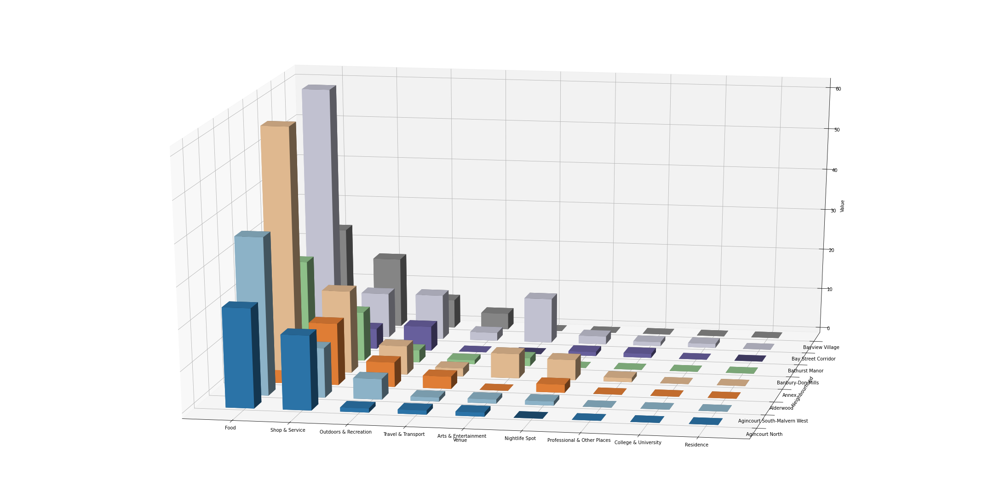

In [ ]:
# 3D Ploting of venue type against neighbourhood
fig = plt.figure(figsize=(30,15))
ax = Axes3D(fig)

# thickness of the bars
dx, dy = .5, .5

# set up positions for the bars 
xpos=np.arange(dfCategoriesDisplay.shape[1])
ypos=np.arange(dfCategoriesDisplay.shape[0])

# set the ticks in the middle of the bars
ax.set_xticks(xpos + dx/2)
ax.set_yticks(ypos + dy/2)

# create meshgrid 
# print xpos before and after this block if not clear
xpos, ypos = np.meshgrid(xpos, ypos)
xpos = xpos.flatten()
ypos = ypos.flatten()

# the bars starts from 0 attitude
zpos=np.zeros(dfCategoriesDisplay.shape).flatten()

# the bars' heights
dz = dfCategoriesDisplay.values.ravel()

# Colors for the bars
bars = dfCategoriesDisplay.shape[0] * dfCategoriesDisplay.shape[1]
colorMap = plt.cm.tab20c
colors = []
for i in range(0, bars):
    colors.append(colorMap(i//dfCategoriesDisplay.shape[1]/dfCategoriesDisplay.shape[0]))
    
# plot data
ax.bar3d(xpos,ypos,zpos,dx,dy,dz,colors)

# put the column / index labels
ax.w_xaxis.set_ticklabels(dfCategoriesDisplay.columns)
ax.w_yaxis.set_ticklabels(dfCategoriesDisplay.index)

ax.set_xlabel('Venue')
ax.set_ylabel('Neighbourhood')
ax.set_zlabel('Value')
ax.view_init(20, -80)
plt.show()


It would seem that most venues are of the Food type. While there are many venues of low amount. It rest to see if the less frequent venues would apply a stronger impact in the prediction of the target variables.

Before we go any futher, lets take a look a the distribution of crime rates through a box diagram.

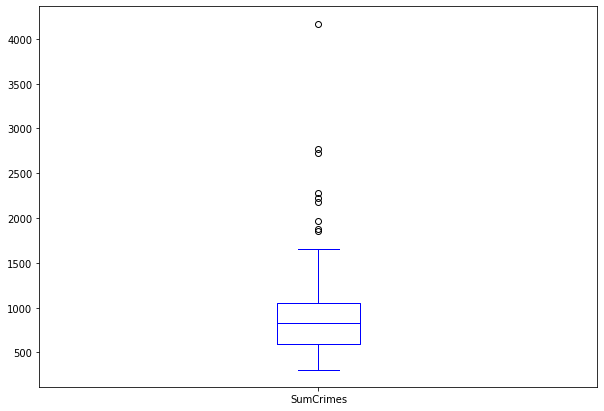

In [ ]:
# Box Diagram plotting
dfCrimesCurated["SumCrimes"].plot(kind='box',
                                  figsize=(10, 7),  # Plot size
                                  color='blue',     # Color
                                  vert=True)        # Vertical or Horizontal


The histogram shows that while the distribution is somewhat homegeneous, there is a significant number of outliers.

Now we will plot the diferent variables against eachother in a scatter plot 

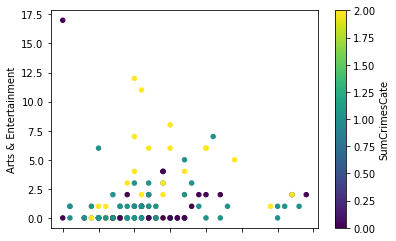

In [ ]:
# ----------------------------------------------------------------------------
# Scatter Plot
#df3.Tranpose.plot(kind='scatter', x='Denmark', y="OdName", figsize=(10, 6), color='darkblue')
dfAnalisis.plot.scatter(x='Shop & Service',
                        y='Arts & Entertainment',
                        c='SumCrimesCate',
                        colormap='viridis')


We can see that as the amount of Art and Shop Venues rises, there is a correlation to the rise of Crime Rates, with a excepction of some outliers. Perhaps they will probe usefull when modeling.

Lets do it for each variable that interest us.

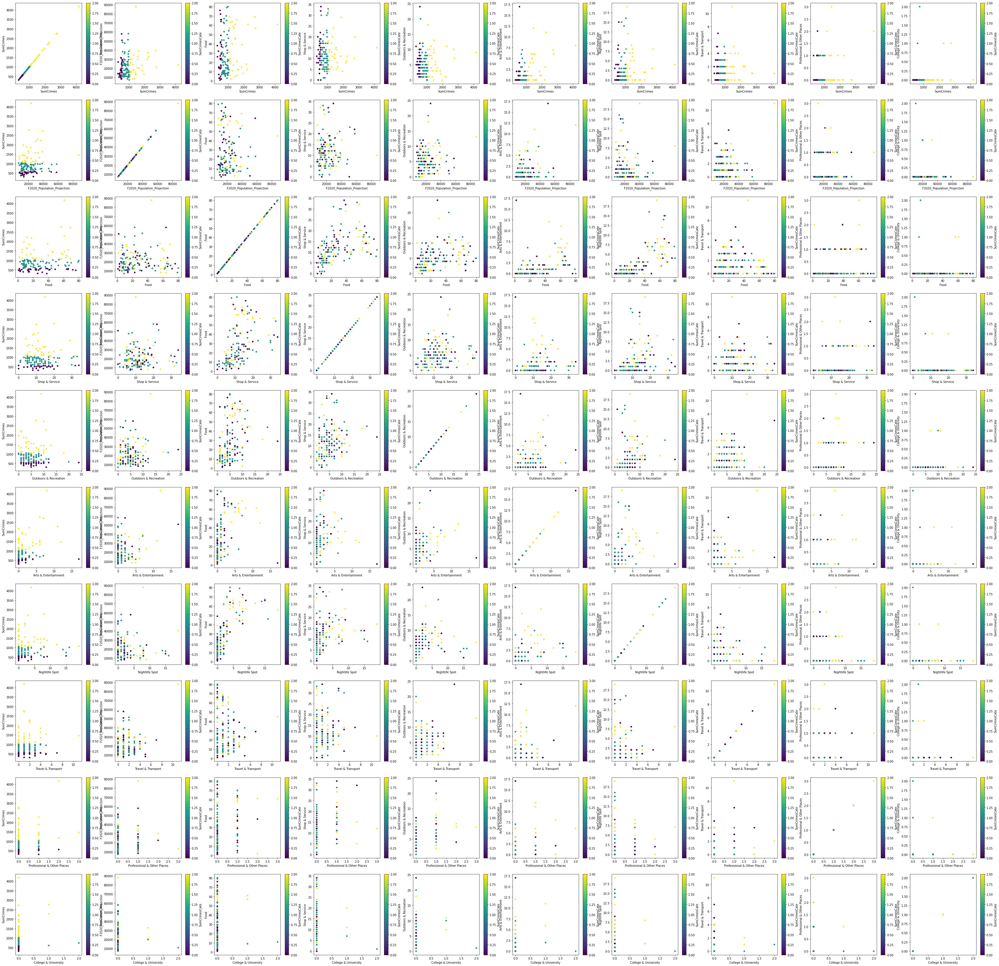

In [ ]:
# Define all parameters of interest.
columns = ['SumCrimes', 'F2020_Population_Projection', 'Food', 'Shop & Service', 'Outdoors & Recreation', 'Arts & Entertainment',
 'Nightlife Spot', 'Travel & Transport', 'Professional & Other Places', 'College & University']#, 'Residence']

# Get dimensionality for plotting
dimmension = len(columns)

# Define figure and axis
fig, axes = plt.subplots(nrows=dimmension, ncols=dimmension, figsize=(60, 60))
# For each variable X
for i, columnX in enumerate(columns):
  # For each variable Y
  for j, columnY in enumerate(columns):
    # Plot X over Y colored by category
    dfAnalisis.plot.scatter(ax=axes[i,j],
                            x=columnX,
                            y=columnY,
                            c='SumCrimesCate',
                            colormap='viridis')


In the first row, the one relating to "SumCrimes" we can see that there is not a strong correlation between that variable and anyother ones.
Which means that perhaps it will be dificult to develop a regresion model with this data.

Looking at the rest of the graphs, we can see some degree of clustering. For example with Food and Nightlife, as these types of venues gets more common, the high crime neighborhoods comes to shine, while the lower crime ones stays mostly in the lower corner where these venues are less frecuent.

After looking at the relationship between pairs variables and the target variable, we will plot 3 variables over the target to see if we there is some insights to gain.

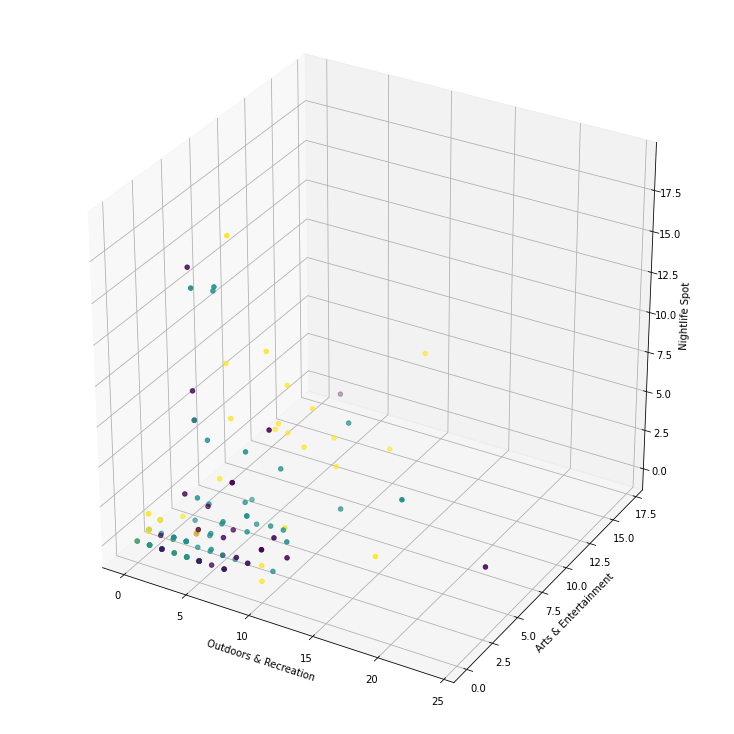

In [ ]:
# Figure creation
fig = plt.figure(figsize=(10,10))
ax = Axes3D(fig)

# Data input
ax.scatter(dfAnalisis["Outdoors & Recreation"], dfAnalisis["Arts & Entertainment"], dfAnalisis["Nightlife Spot"],   c=dfAnalisis["SumCrimesCate"], cmap='viridis')

# Labeling
ax.set_xlabel('Outdoors & Recreation')
ax.set_ylabel('Arts & Entertainment')
ax.set_zlabel('Nightlife Spot')

# Plot
plt.show()


Once again, we can see again some clustering, this time of the lower crime rates neighborhoods. However the correlation is not too strong.

Finally to corroborate our guess that there is not a strong linear correlation between the number of venues and the crime rates, lets take a look at the correlation matrix.

In [ ]:
# Correlation between variables
dfAnalisis.corr()

,F2020_Population_Projection,SumCrimes,SumCrimesCate,Food,Shop & Service,Outdoors & Recreation,Travel & Transport,Arts & Entertainment,Nightlife Spot,Professional & Other Places,College & University,Residence
F2020_Population_Projection,1.000000,0.161420,0.137079,0.018100,0.053978,0.095956,0.265162,0.342805,0.000302,0.057110,-0.035248,-0.008117
SumCrimes,0.161420,1.000000,0.743733,0.201849,0.031395,-0.016773,0.034694,0.376190,0.110234,0.165160,0.151501,-0.085305
SumCrimesCate,0.137079,0.743733,1.000000,0.128878,-0.008712,-0.026267,-0.018546,0.212822,0.144440,0.057977,0.091526,-0.085126
Food,0.018100,0.201849,0.128878,1.000000,0.477636,0.348055,-0.082167,0.416489,0.718225,0.236108,0.013276,-0.022994
Shop & Service,0.053978,0.031395,-0.008712,0.477636,1.000000,0.206624,0.076938,0.107948,0.266252,0.242590,-0.092031,0.156483
Outdoors & Recreation,0.095956,-0.016773,-0.026267,0.348055,0.206624,1.000000,0.191736,0.274921,0.216842,0.418412,0.028549,0.021242
Travel & Transport,0.265162,0.034694,-0.018546,-0.082167,0.076938,0.191736,1.000000,0.160539,-0.063158,0.098267,-0.040315,-0.066834
Arts & Entertainment,0.342805,0.376190,0.212822,0.416489,0.107948,0.274921,0.160539,1.000000,0.342067,0.263461,0.153441,-0.043753
Nightlife Spot,0.000302,0.110234,0.144440,0.718225,0.266252,0.216842,-0.063158,0.342067,1.000000,0.071396,0.002542,-0.027901
Professional & Other Places,0.057110,0.165160,0.057977,0.236108,0.242590,0.418412,0.098267,0.263461,0.071396,1.000000,-0.015477,-0.057579


The table corroborates our previous impresion.

After a initial analysis we can conclude that the relation between the predictors and the target variable is most likely not of linear nature, but given that there is some degree of clustering perhaps we can develop some other predictive modeling.

# Predictive Modeling <a name="PredictiveModeling">

> ## Preprocessing <a name="Preprocessing"></a>

Before we engage with modeling there is an important step we complete first.

We need to **Normalize** the data before we use it for modeling, otherwise the different scales of the variables could impact negatively the training of the model.


Let's look again at the analysis data frame and see the difference between the attributes of ours instances.


In [ ]:
dfAnalisis.head() # Displat dataframe


,Neighbourhood,F2020_Population_Projection,SumCrimes,SumCrimesBinned,SumCrimesCate,Food,Shop & Service,Outdoors & Recreation,Travel & Transport,Arts & Entertainment,Nightlife Spot,Professional & Other Places,College & University,Residence
0,Yonge-St.Clair,14083,310.030420,Low,0,38,11,11,2,0,3,1,0,0
1,York University Heights,30277,2179.181277,High,2,18,8,1,2,0,2,0,0,0
2,Lansing-Westgate,18146,931.758686,Medium,1,3,5,5,0,0,0,1,0,0
3,Yorkdale-Glen Park,17560,1880.544411,High,2,39,29,2,0,1,0,1,0,0
4,Stonegate-Queensway,27410,669.804890,Medium,1,9,5,4,0,0,0,0,0,0


Is easy to see that the difference in value between "Yonge-St.Clair" and "York University Heights" Population Projection is orders of magnitude higher than the difference between this two neighbourhoods Food Venues number.

Here is normalization comes into play. There are many forms of normalization. We will use a Standard Scaler which transforms the data so it has mean 0 and variance of 1 unit.


Given that not all fields should be normalized we have to select what data we want to process and then resign the new values over the old ones.


As customary, some imports.


In [ ]:
from sklearn import preprocessing # Imports for normalization


Now we process with the normalization.


In [ ]:
# We select the atributes we want to process
toNormalize = dfAnalisis[['F2020_Population_Projection', 'Food', 'Shop & Service', 'Outdoors & Recreation', 'Arts & Entertainment',
 'Nightlife Spot', 'Travel & Transport', 'Professional & Other Places', 'College & University', "SumCrimes"] ]#, 'Residence']

# Normalization
normalized = preprocessing.StandardScaler().fit(toNormalize).transform(toNormalize.astype(float))

# Reasign the data
dfAnalisis[['F2020_Population_Projection', 'Food', 'Shop & Service', 'Outdoors & Recreation', 'Arts & Entertainment',
 'Nightlife Spot', 'Travel & Transport', 'Professional & Other Places', 'College & University', "SumCrimes"] #, 'Residence']
 ] = normalized
 

We check the data once again.


In [ ]:
dfAnalisis.head() # Displat dataframe


,Neighbourhood,F2020_Population_Projection,SumCrimes,SumCrimesBinned,SumCrimesCate,Food,Shop & Service,Outdoors & Recreation,Travel & Transport,Arts & Entertainment,Nightlife Spot,Professional & Other Places,College & University,Residence
0,Yonge-St.Clair,-0.648114,-1.202907,Low,0,0.468096,-0.137582,1.476596,0.362826,-0.562201,0.180699,1.434860,-0.161796,0
1,York University Heights,0.724596,2.373013,High,2,-0.473477,-0.568810,-1.123699,0.362826,-0.562201,-0.094278,-0.478287,-0.161796,0
2,Lansing-Westgate,-0.303708,-0.013463,Medium,1,-1.179656,-1.000038,-0.083581,-0.861166,-0.562201,-0.644233,1.434860,-0.161796,0
3,Yorkdale-Glen Park,-0.353381,1.801683,High,2,0.515175,2.449785,-0.863669,-0.861166,-0.164685,-0.644233,1.434860,-0.161796,0
4,Stonegate-Queensway,0.481570,-0.514613,Medium,1,-0.897184,-1.000038,-0.343610,-0.861166,-0.562201,-0.644233,-0.478287,-0.161796,0


While there are still some gaps between the different attributes of the instances, the distance in these gaps has been dramatically reduced.

Now, our data is ready for a predictive modeling.

> ## A Regression Approach <a name="RegressionApproach"></a>

Even though we have already stated that there is not a strong linear correlation between the variables, there might still exist a polynomial one.
We will transform the data and use a feature selector to try and develop an accurate regressor of the variable *SumCrimes*.

In [ ]:
dfAnalisis.corr().iloc[1] # Show up the linear correlation with the target variable "SumCrimes"

F2020_Population_Projection    0.161420
SumCrimes                      1.000000
SumCrimesCate                  0.743733
Food                           0.201849
Shop & Service                 0.031395
Outdoors & Recreation         -0.016773
Travel & Transport             0.034694
Arts & Entertainment           0.376190
Nightlife Spot                 0.110234
Professional & Other Places    0.165160
College & University           0.151501
Residence                     -0.085305
Name: SumCrimes, dtype: float64

We start by defining the target and the predictive variables.
The target variable will be *SumCrimes* and the prediction variables will be all the other ones except *SumCrimesCate* which is derived from the former one.


In [ ]:
dfAnalisis.head(1)

,Neighbourhood,F2020_Population_Projection,SumCrimes,SumCrimesBinned,SumCrimesCate,Food,Shop & Service,Outdoors & Recreation,Travel & Transport,Arts & Entertainment,Nightlife Spot,Professional & Other Places,College & University,Residence
0,Yonge-St.Clair,-0.648114,-1.202907,Low,0,0.468096,-0.137582,1.476596,0.362826,-0.562201,0.180699,1.43486,-0.161796,0


In [ ]:
# Regresion variables
X = dfAnalisis[['F2020_Population_Projection', 'Food', 'Shop & Service', 'Outdoors & Recreation', 'Arts & Entertainment',
 'Nightlife Spot', 'Travel & Transport', 'Professional & Other Places', 'College & University', 'Residence'] ]
# Target variable
Y = dfAnalisis["SumCrimes"]


Now we import the library necessary for Polynomial elevation.


In [ ]:
from sklearn.preprocessing import PolynomialFeatures # Library for Polynomial Featuring


The dimensionality of the data before transformation is:


In [ ]:
print("Number of instances: " + str(X.shape[0])) # Instances
print("Number of variables: " + str(X.shape[1])) # Variables


Number of instances: 140
Number of variables: 10


Then we use Polynomial Features to transform the data from first degree to second degree.


In [ ]:
pr = PolynomialFeatures(degree=2) # Polynomial Feature of second degree
X = pr.fit_transform(X) # Polynomial Feature Fitting and Reasignment


The dimensionality of the data after transformation is:


In [ ]:
print("Number of instances: " + str(X.shape[0])) # Instances
print("Number of variables: " + str(X.shape[1])) # Variables


Number of instances: 140
Number of variables: 66


66 Variables could be too much for a good model, luckily we won't need to pick them manually.


We can use recursive feature elimination (RFE) to pick for us. Combined with a Grid Search we get a powerfull tool for model development.

In [ ]:
from sklearn.model_selection import KFold # Folds for Grid Search 
from sklearn.model_selection import GridSearchCV # For Grid Search

from sklearn.linear_model import LinearRegression # For Linear Regresion Model

from sklearn.feature_selection import RFE # For Recursive Feature Elimination


In [ ]:
# Folds for Cross Grid Search, 5 splits of 20% test, 80% training
folds = KFold(n_splits = 5, shuffle = True, random_state = 100)

# Maximun number of parameters
numFeatures = X.shape[1]

# Specify range of hyperparameters
hyperParams = [{'n_features_to_select': list(range(1, numFeatures))}]

# Specify model
lm = LinearRegression()
rfe = RFE(lm)             

# Set up GridSearchCV
gridCV = GridSearchCV(estimator = rfe, # Model
                        param_grid = hyperParams, # Params
                        scoring= 'r2', # Scoring 
                        cv = folds, # Folding
                        return_train_score=True) # Return train data   

# Fit the model
gridCV.fit(X, Y)                  

GridSearchCV(cv=KFold(n_splits=5, random_state=100, shuffle=True),
             error_score=nan,
             estimator=RFE(estimator=LinearRegression(copy_X=True,
                                                      fit_intercept=True,
                                                      n_jobs=None,
                                                      normalize=False),
                           n_features_to_select=None, step=1, verbose=0),
             iid='deprecated', n_jobs=None,
             param_grid=[{'n_features_to_select': [1, 2, 3, 4, 5, 6, 7, 8, 9,
                                                   10, 11, 12, 13, 14, 15, 16,
                                                   17, 18, 19, 20, 21, 22, 23,
                                                   24, 25, 26, 27, 28, 29, 30, ...]}],
             pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
             scoring='r2', verbose=0)

Now that the search is done, we can get the results.

In [ ]:
# Grid Search results
data = pd.DataFrame.from_dict(gridCV.cv_results_) # Get Results
data.sort_values(by=['rank_test_score'], inplace= True) # Sort them by ranking
data # Show dataframe

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_features_to_select,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.111565,0.013186,0.000823,0.000021,1,{'n_features_to_select': 1},-2.221034e-02,-0.029095,-0.063317,0.019891,0.016291,-1.568807e-02,3.091717e-02,1,0.009107,0.011693,0.007492,0.187641,0.005044,0.044195,0.071755
1,0.100740,0.001978,0.000804,0.000003,2,{'n_features_to_select': 2},-6.777429e-01,-0.029095,-0.088469,-0.081771,0.373814,-1.006525e-01,3.357909e-01,2,0.238858,0.011693,0.248355,0.229632,0.195657,0.184839,0.088380
2,0.100735,0.002571,0.000808,0.000008,3,{'n_features_to_select': 3},-1.946440e+00,-0.021899,-0.198193,-0.081429,0.373814,-3.748295e-01,8.089836e-01,3,0.267237,0.092708,0.273682,0.229634,0.195657,0.211783,0.065824
3,0.098245,0.001937,0.000805,0.000014,4,{'n_features_to_select': 4},-3.795639e+00,-0.069340,-0.204531,-0.259528,0.273898,-8.110283e-01,1.503799e+00,4,0.363234,0.280209,0.274516,0.305579,0.265280,0.297764,0.035359
4,0.100416,0.005045,0.000806,0.000007,5,{'n_features_to_select': 5},-5.986995e+00,-0.073261,-0.474599,-0.559824,0.332846,-1.352366e+00,2.338993e+00,5,0.372832,0.281684,0.371321,0.403521,0.273192,0.340510,0.052833
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48,0.044311,0.005112,0.000848,0.000019,49,{'n_features_to_select': 49},-3.223226e+26,-0.925211,-9.307965,-73.093149,-16.732428,-6.446452e+25,1.289290e+26,61,0.729168,-0.485436,0.735870,0.814436,-0.126232,0.333561,0.535119
60,0.015649,0.000030,0.000815,0.000011,61,{'n_features_to_select': 61},-3.255040e+26,-1.924782,-9.892216,-84.174099,-9.505024,-6.510079e+25,1.302016e+26,62,0.729790,-1.774647,0.737216,0.820153,0.277509,0.158004,0.984915
49,0.039797,0.000267,0.000832,0.000015,50,{'n_features_to_select': 50},-3.324011e+26,-1.773769,-9.014274,-73.175199,-38.460647,-6.648021e+25,1.329604e+26,63,0.729689,-1.511078,0.735984,0.814595,-1.101425,-0.066447,1.020990
52,0.034408,0.000509,0.000852,0.000018,53,{'n_features_to_select': 53},-3.820775e+26,-4.343584,-9.161917,-85.073958,-9.025610,-7.641550e+25,1.528310e+26,64,0.729185,-1.790716,0.735815,0.818749,-0.258432,0.046920,1.000593


The data mean test score is the value we are looking for. It's the mean of the test score for each fold(Five folds). Ensuring that we don't get unrepresentative values from a good or bad seed.

It would seem that the best model we can develop with this data has an $ R^2 $  of near 0. Which means that our data is not fit at all to develop a predictive linear regressor.

These are bad news but not all hope is lost. We can still use the categorical variable SumCrimesCate to develop a Classification  model. Given that this feature is more lax in its criteria perhaps we can still obtain some information.

Even though we already know that our model is not good, lets plot the evolution of the scoring as the number of features rises.


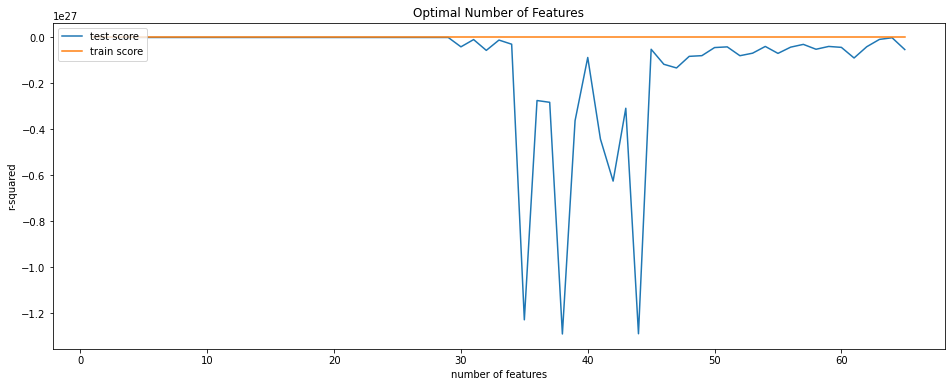

In [ ]:
# plotting results
plt.figure(figsize=(16,6))

# Plot train vs test
plt.plot(data["param_n_features_to_select"], data["mean_test_score"])
plt.plot(data["param_n_features_to_select"], data["mean_train_score"])

# Axis and title labeling
plt.xlabel('number of features')
plt.ylabel('r-squared')
plt.title("Optimal Number of Features")
# Legend
plt.legend(['test score', 'train score'], loc='upper left')


In the graph we can see that after a certain point, the numbers of features correspond with a drop in test score. 
This is likely because of overfiting.


> ## A Clasification Approach <a name="ClassificationApproach"></a>

Previously we tried to do a regression approach to the problem, but with no avail.

Now we will try to do the same, but this time we want to classify the neighbourhoods into low, medium or high crime rates. This is an easier endeavor as classification a neighborhood is akin to give it a value but instead we are assigning it an interval.

There are plenty of classification models, from which we will chose K-neighbors because of the previous clustering we saw in the preliminary analysis. And a classification tree because of their good adaptivity to most problems.


The process is similar to the regression we previously tried.
* We define predictive and target variables.
* We define a model.
* We train it.
* We test it.

The predictive features will be the same as in the regression part. The target, however, is now **SumCrimesCate**.


In [ ]:
# Regresion variables
X = dfAnalisis[['F2020_Population_Projection', 'Food', 'Shop & Service', 'Outdoors & Recreation', 'Arts & Entertainment',
 'Nightlife Spot', 'Travel & Transport', 'Professional & Other Places', 'College & University', 'Residence'] ]
# Target variable
Y = dfAnalisis["SumCrimesCate"]


### KNeighbors Classification

We already have the variables for the model defined, so we import the libraries necessaries.


In [ ]:
import numpy as np # Tool

from sklearn.neighbors import KNeighborsClassifier # For KNeighbors Clasification

from sklearn.model_selection import GridSearchCV # For Grid Search

# Diferent Clasification Scorings
from sklearn.metrics import jaccard_score
from sklearn.metrics import f1_score


Let's develop the K-Neighbour model.

Once again let's use a Grid search to find the optimal values for the hyperparameters of the model.


In [ ]:
Ks = 11 # Maximun number of neighbours for grid search
parameters = [{'n_neighbors': np.arange(2, Ks).tolist()}] # Parameters for a Grid Search

knn = KNeighborsClassifier() # KNeighborsClassifier model
Grid = GridSearchCV(knn, parameters, cv=5, scoring ='f1_weighted') # Grid Search 5 folds
Grid.fit(X, Y) # Do the Search
data = pd.DataFrame.from_dict(Grid.cv_results_) # Get Results
BestKNN = Grid.best_estimator_ # Get Best Model

YPred = BestKNN.predict(X) # Get Prediction
Grid.best_params_ # Show best number of neighbours

{'n_neighbors': 7}

Seems like seven is the optimal number of neighbors.
Let's look now at some scorings.
F1 score is the harmonic average of the precision and recall of the model.

With precision being the rate of positives identification that were correct and recall the rate of true positives that were identified.


In [ ]:
f1_score(YPred, Y, average='weighted') # F1_score


0.5824574085067673

A score of 0.5824 is not perfect, but it says that our model is much better than our previous regression one.


Now let's look at the Jaccard index which is the similarity between the prediction that the model gave us, and the real data.


In [ ]:
jaccard_score(YPred, Y, average='weighted') # Jaccard_score


0.4232659449589148

With a score of 0.4232, we can conclude that half of the predictions our model has made are accurate.


Lets plot a mean test score over increasing number of neighbors.


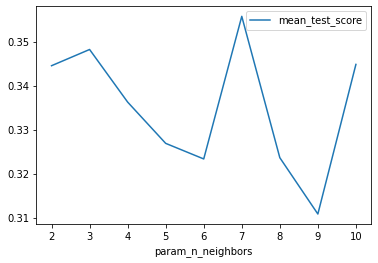

In [ ]:
data[["param_n_neighbors", "mean_test_score"]].plot(kind='line', 
                                                    x='param_n_neighbors', 
                                                    y='mean_test_score') # Plot Score vs n_neighbors

We can see that it peaks at seven neighbors.

We can see the full detail of the search in the following data frame.

In [ ]:
# Grid Search results
data = pd.DataFrame.from_dict(Grid.cv_results_) # Get Results
data.sort_values(by=['rank_test_score'], inplace= True) # Sort them by ranking
data.head(5) # Show dataframe

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_neighbors,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
5,0.001612,0.000042,0.004027,0.001721,7,{'n_neighbors': 7},0.340074,0.310256,0.470779,0.354701,0.303030,0.355768,0.060544,1
1,0.001778,0.000358,0.002986,0.000190,3,{'n_neighbors': 3},0.498316,0.243697,0.368182,0.247619,0.383333,0.348230,0.095085,2
8,0.001614,0.000028,0.003186,0.000296,10,{'n_neighbors': 10},0.345878,0.385784,0.305556,0.362637,0.324324,0.344836,0.028137,3
0,0.001995,0.000883,0.002898,0.000201,2,{'n_neighbors': 2},0.436147,0.228571,0.322955,0.271795,0.463235,0.344541,0.091309,4
2,0.001630,0.000034,0.002997,0.000021,4,{'n_neighbors': 4},0.338207,0.253438,0.365900,0.302381,0.421429,0.336271,0.056821,5


The mean test score of the folds in the search was 0.355768 for our best model.
A significant advance from our lineal regressor. Now let's see if the Classification Tree approach provides better results. 

### Decision Tree Classification


As stated, we are going to develop one last model, a decision tree.

The decision to employ a tree is taken given how well they behave in many situations.

Like costumary, imports.

In [ ]:
from sklearn.tree import DecisionTreeClassifier # For decision tree


Once again, we employ grid search to obtain optimal depth.

In [ ]:
max_depths = 15 # Max depth of the tree
parameters = [{'max_depth': np.arange(3,max_depths).tolist()}] # Parameters for a Grid Search

dTree = DecisionTreeClassifier(criterion="entropy") # Tree Model
Grid = GridSearchCV(dTree, parameters, cv=4, scoring ='f1_weighted') # Grid Search 4 folds
Grid.fit(X, Y) # Do the Search
data = pd.DataFrame.from_dict(Grid.cv_results_) # Get Results
BestTree = Grid.best_estimator_ # Get Best Model

YPred = BestTree.predict(X) # Get Prediction
Grid.best_params_

{'max_depth': 6}

Let's proceed with scoring.

F1 score:

In [ ]:
f1_score(YPred, Y, average='weighted') # F1_score


0.8087046604240663

Jaccard index:

In [ ]:
jaccard_score(YPred, Y, average='weighted') # Jaccard_score


0.6825433381208458

The scores for our whole dataset seem to be a little better than with the KNeighbors Classifier.

Let's see the tree performance as the max depth rises.

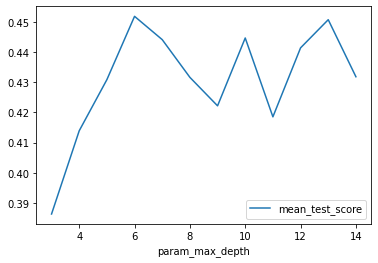

In [ ]:
data[["param_max_depth", "mean_test_score"]].plot(kind='line', 
                                                    x='param_max_depth', 
                                                    y='mean_test_score') # Plot Score vs Dpeth

And the whole results from the search.

In [ ]:
# Grid Search results
data = pd.DataFrame.from_dict(Grid.cv_results_) # Get Results
data.sort_values(by=['rank_test_score'], inplace= True) # Sort them by ranking
data.head(5) # Show dataframe

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
3,0.002335,0.000448,0.002373,0.001077,6,{'max_depth': 6},0.542061,0.388278,0.435378,0.441558,0.451819,0.056028,1
10,0.002073,0.000029,0.001378,0.000004,13,{'max_depth': 13},0.514559,0.424026,0.454404,0.409836,0.450706,0.040228,2
7,0.002097,0.000046,0.001424,0.000029,10,{'max_depth': 10},0.485714,0.450107,0.430344,0.412449,0.444654,0.027192,3
4,0.002183,0.000236,0.001418,0.000013,7,{'max_depth': 7},0.514515,0.431221,0.431880,0.398817,0.444108,0.042790,4
9,0.002086,0.000045,0.001420,0.000013,12,{'max_depth': 12},0.485714,0.473668,0.395776,0.410380,0.441384,0.038887,5


One important feature of trees is that we can plot them to see their nodes and how each variable influences its outcome.
  

In [ ]:
from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(BestTree, out_file='tree.dot', 
                       feature_names = ['F2020_Population_Projection', 'Food', 'Shop & Service', 'Outdoors & Recreation',
                                         'Arts & Entertainment', 'Nightlife Spot', 'Travel & Transport',
                                         'Professional & Other Places', 'College & University', 'Residence'],
                       class_names= ['Low', 'Medium', 'High'], 
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')

Now that we can see its structure, we are going to need some context to understand it.


We can use the distribution (Quartiles) of each variable to make sense of the tree.

In [ ]:
X.describe()

,F2020_Population_Projection,Food,Shop & Service,Outdoors & Recreation,Arts & Entertainment,Nightlife Spot,Travel & Transport,Professional & Other Places,College & University,Residence
count,140.000000,140.000000,140.000000,140.000000,140.000000,140.000000,140.000000,140.000000,140.000000,140.000000
mean,21728.871429,28.057143,11.957143,5.321429,1.414286,2.342857,1.407143,0.250000,0.035714,0.014286
std,11839.460093,21.317325,6.981859,3.859526,2.524657,3.649719,1.639865,0.524576,0.221529,0.119092
min,7130.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,13227.250000,10.750000,7.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,18378.000000,21.500000,11.000000,5.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000
75%,26598.250000,41.250000,15.000000,7.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000
max,87808.000000,80.000000,34.000000,24.000000,17.000000,19.000000,11.000000,3.000000,2.000000,1.000000


Together with the aid of the tree and the distribution of the data, we can gain some insight on how the model works.

For example: the first node differentiates between neighbourhoods with four or less "Arts & Entertainment" venues. But are those many or few? We need to look at the distribution to understand it. With a simple look we know that 75% of neighbourhoods have two or less locales of that type. The tree also tells us that, of those which do have five or more, 9/13 have high crime rates. This is valuable information as it makes it apparent that high density of these types of venues leads to higher crime.


From the tree we can conclude that most of the low crime neighbourhoods have median or less population projection, under 1º quartile Outdoors & Recreation and below 3º quartile Arts & Entertainment venues.

We can also say low population usually influences the neighborhood so it doesn't have high crime rates. (This doesn't mean the crime rates are necessarily low).

Also is notable that sometimes is difficult to differentiate between high and medium crime neighbourhoods.

# Conclusions <a name="Conclusions"></a>

At the start of this notebook, we aimed ourselves to find some correlation between crime rates and venues, and get answers to some questions.

After some work we came to the conclusion that there is some degree of clustering between the neighborhoods. We did this through or preliminary analysis and during the classification approach with the k-neighbours classificator. However, even though there is a measure of similitude between same type, this correlation is not very strong and therefore should be used with caution when trying to make a prediction.

We also found out that our data is unfit at all for a linear/polynomial regression model and that we should strafe away from that.

And finally, thanks to decision tree classification we came to some answer to the questions we formulated at the start.

* **Is there a correspondence between a predominant type of business and an exceptional high or low criminality?**

>After the analysis we cannot say with certainty that there is a definitive factor that defines high or low crime rates. Is more likely that there are a set of circumstances that, together, influences the neighborhood in a way or another.

* **Are more diverse neighborhoods less crime prone?**

> We cannot conclude that with the data that we gathered. It is notable to say that usually, most low crime neighborhoods have low amounts of Outdoors & Recreation and Arts & Entertainment venues.

* **What characterizes neighborhoods of notable delinquency?**

> With the current data at our disposal in this analysis is hard to differentiate between low and medium crime neighborhoods. However, contrary to what could believe, high population neighborhoods don't correlate with high crime rates neighborhoods.


Finally, to conclude this notebook I would like to note that given the requisite of using *FOURSQUARE Places API* to acquire is not without consequence. While the API is great for commercial use, the restrictions that it applies to us are very important, namely that we can only get 50 venues/locales per neighborhood and the randomness of the results it returns, don't allow for a proper analysis of the zone.
